In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

We'll go through learning feature embeddings using different loss functions on the MNIST dataset.

## Prepare MNIST dataset
We'll be working on MNIST dataset

In [2]:
import sys
import torch
from torchvision.datasets import MNIST
from torchvision import transforms
from trainer import train_and_visualize, visualize_evolution
from networks import SiameseNet, ClassificationNet, TripletNet

mean, std = 0.1307, 0.3081

train_dataset = MNIST('../data/MNIST', train=True, download=True,
                             transform=transforms.Compose([
                                 transforms.ToTensor(),
                                 transforms.Normalize((mean,), (std,))
                             ]))
test_dataset = MNIST('../data/MNIST', train=False, download=True,
                            transform=transforms.Compose([
                                transforms.ToTensor(),
                                transforms.Normalize((mean,), (std,))
                            ]))
n_classes = 10

## 1. Baseline: Supervised Embedding Learning with Softmax
We'll train the model for classification and use outputs of penultimate layer as embeddings. This model has three projection layers (256, 256, 2) that reduces the embedding dimension down to 2.

ClassificationNet(
  (embedding_net): EmbeddingNet(
    (convnet): Sequential(
      (0): Conv2d(1, 32, kernel_size=(5, 5), stride=(1, 1))
      (1): PReLU(num_parameters=1)
      (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1))
      (4): PReLU(num_parameters=1)
      (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (fc): Sequential(
      (0): Linear(in_features=1024, out_features=256, bias=True)
      (1): PReLU(num_parameters=1)
      (2): Linear(in_features=256, out_features=256, bias=True)
      (3): PReLU(num_parameters=1)
      (4): Linear(in_features=256, out_features=2, bias=True)
    )
  )
  (nonlinear): PReLU(num_parameters=1)
  (fc1): Linear(in_features=2, out_features=10, bias=True)
)


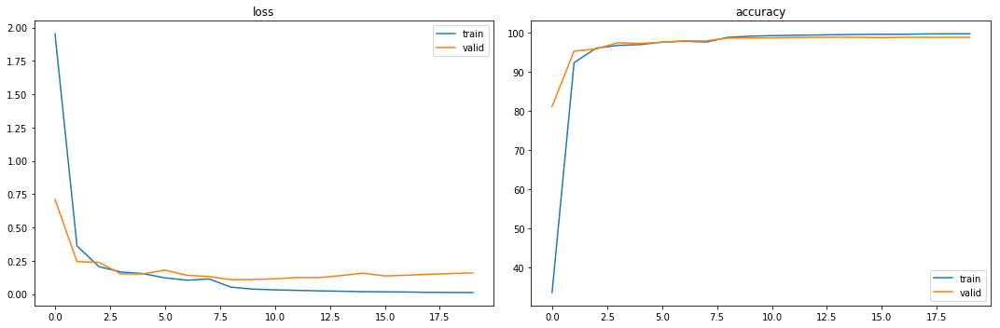

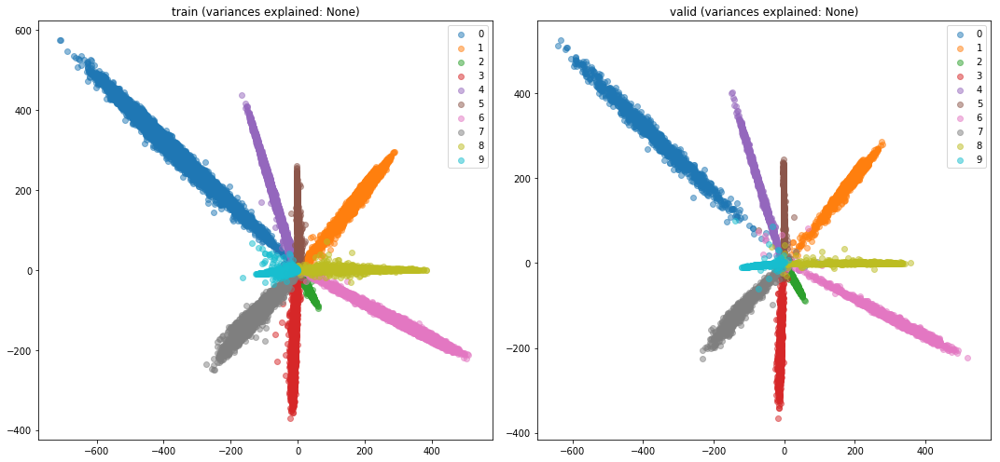

In [3]:
from networks import ClassificationNet
train_and_visualize(train_dataset, test_dataset, dataset_wraper=None, projection_layers=[256, 256, 2], model=ClassificationNet, loss_fn=torch.nn.NLLLoss(), n_epochs=20)

<font color='blue'>While the embeddings look separable (which is what we trained them for), they don't have good metric properties. They might not be the best choice as a descriptor for new classes.</font>

**What happens if the projection layer is removed?**

ClassificationNet(
  (embedding_net): EmbeddingNet(
    (convnet): Sequential(
      (0): Conv2d(1, 32, kernel_size=(5, 5), stride=(1, 1))
      (1): PReLU(num_parameters=1)
      (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1))
      (4): PReLU(num_parameters=1)
      (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (fc): Sequential()
  )
  (nonlinear): PReLU(num_parameters=1)
  (fc1): Linear(in_features=1024, out_features=10, bias=True)
)


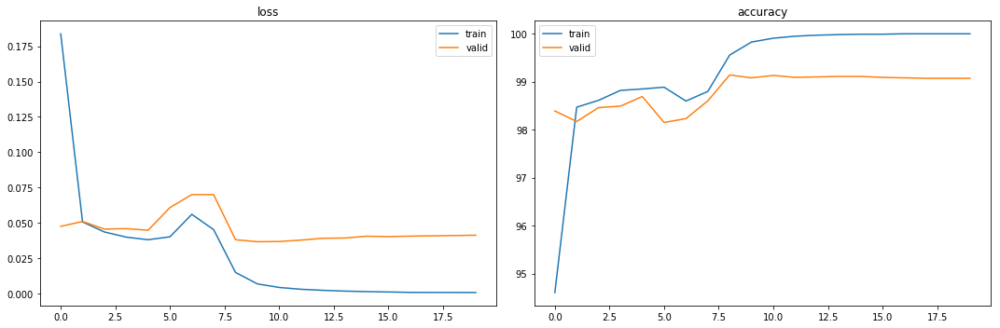

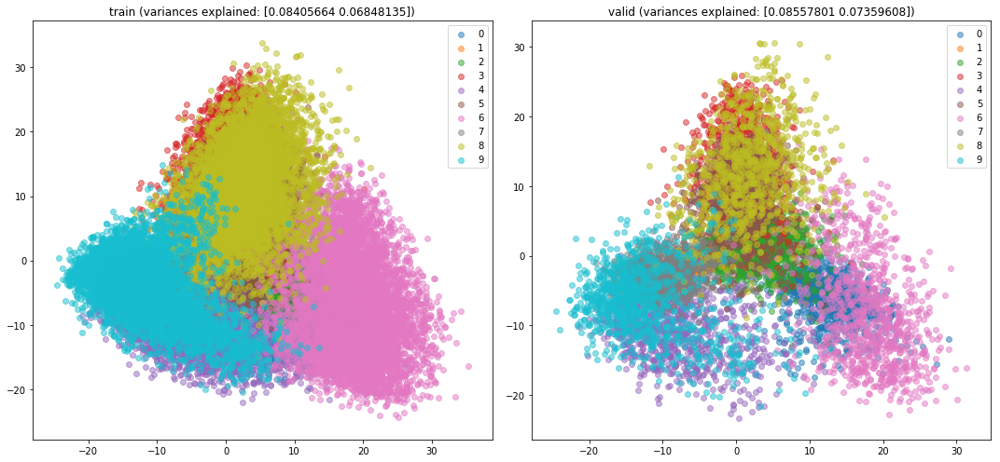

In [4]:
from networks import ClassificationNet
train_and_visualize(train_dataset, test_dataset, dataset_wraper=None, projection_layers=[], model=ClassificationNet, loss_fn=torch.nn.NLLLoss(), n_epochs=20)

<font color='blue'>Removing the projection layers seem to give much cluttered metric space. However, as the two components can only explain about 15% of the variances, there might exist a high dimensional manifold with good separation.</font>

**What happens if the projection has only one dense layer?**

ClassificationNet(
  (embedding_net): EmbeddingNet(
    (convnet): Sequential(
      (0): Conv2d(1, 32, kernel_size=(5, 5), stride=(1, 1))
      (1): PReLU(num_parameters=1)
      (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1))
      (4): PReLU(num_parameters=1)
      (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (fc): Sequential(
      (0): Linear(in_features=1024, out_features=2, bias=True)
    )
  )
  (nonlinear): PReLU(num_parameters=1)
  (fc1): Linear(in_features=2, out_features=10, bias=True)
)


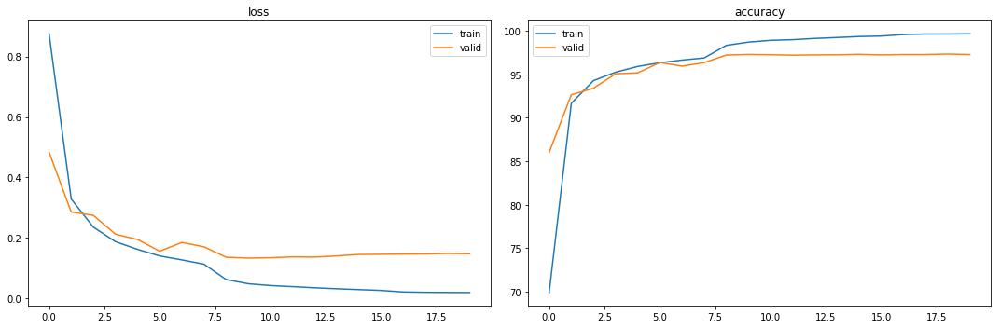

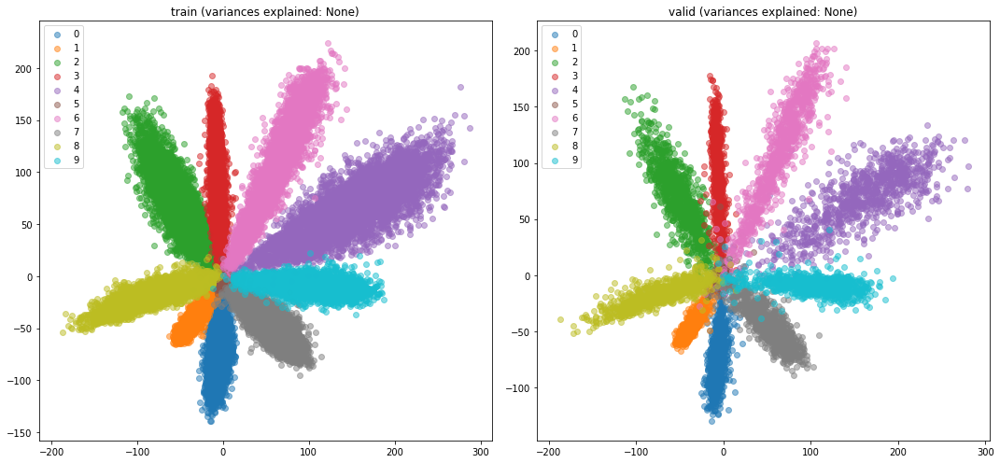

In [5]:
from networks import ClassificationNet
train_and_visualize(train_dataset, test_dataset, dataset_wraper=None, projection_layers=[2], model=ClassificationNet,loss_fn=torch.nn.NLLLoss(), n_epochs=20)

**How does the metric space evolve over time?**

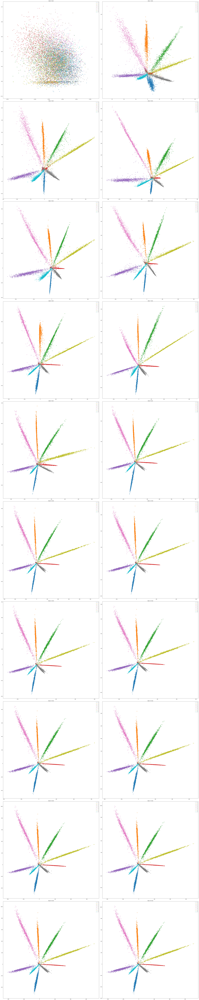

In [6]:
from networks import ClassificationNet
visualize_evolution(train_dataset, test_dataset, dataset_wraper=None, projection_layers=[256, 256, 2], model=ClassificationNet, loss_fn=torch.nn.NLLLoss(), n_epochs=20)

**What about a small projection layer?**

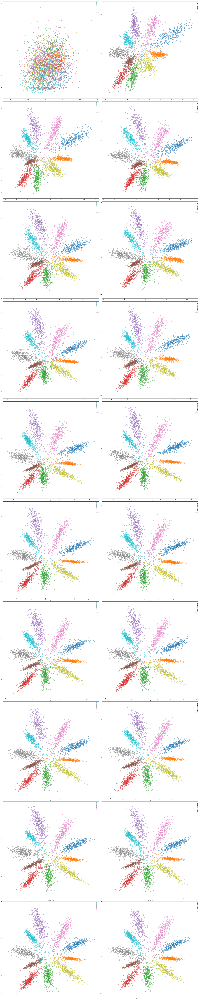

In [7]:
from networks import ClassificationNet
visualize_evolution(train_dataset, test_dataset, dataset_wraper=None, projection_layers=[2], model=ClassificationNet, loss_fn=torch.nn.NLLLoss(), n_epochs=20)

## 2. Siamese network: contrastive loss
Now we'll train a siamese network that takes a pair of images and trains the embeddings so that the distance between them is minimized if their from the same class or greater than some margin value if they represent different classes.
We'll minimize a contrastive loss function*:
$$L_{contrastive}(x_0, x_1, y) = \frac{1}{2} y \lVert f(x_0)-f(x_1)\rVert_2^2 + \frac{1}{2}(1-y)\{max(0, m-\lVert f(x_0)-f(x_1)\rVert_2)\}^2$$

*Raia Hadsell, Sumit Chopra, Yann LeCun, [Dimensionality reduction by learning an invariant mapping](http://yann.lecun.com/exdb/publis/pdf/hadsell-chopra-lecun-06.pdf), CVPR 2006*

SiameseNet(
  (embedding_net): EmbeddingNet(
    (convnet): Sequential(
      (0): Conv2d(1, 32, kernel_size=(5, 5), stride=(1, 1))
      (1): PReLU(num_parameters=1)
      (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1))
      (4): PReLU(num_parameters=1)
      (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (fc): Sequential(
      (0): Linear(in_features=1024, out_features=256, bias=True)
      (1): PReLU(num_parameters=1)
      (2): Linear(in_features=256, out_features=256, bias=True)
      (3): PReLU(num_parameters=1)
      (4): Linear(in_features=256, out_features=2, bias=True)
    )
  )
)


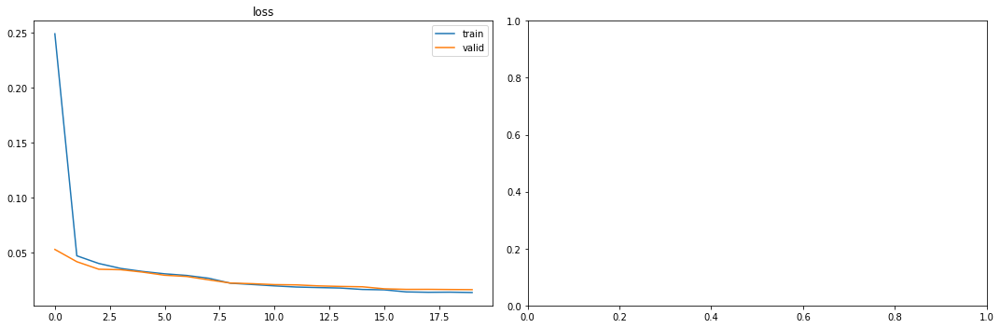

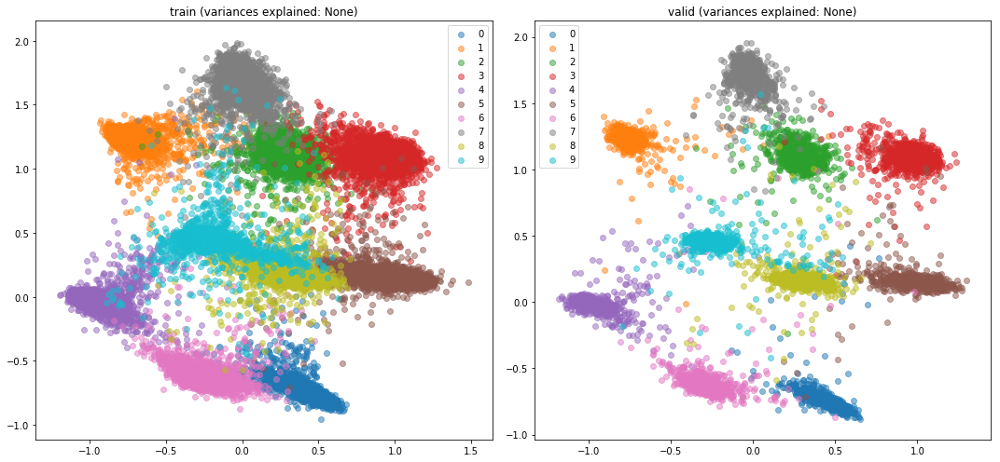

In [8]:
from datasets import SiameseMNIST
from losses import ContrastiveLoss

train_and_visualize(train_dataset, test_dataset, dataset_wraper=SiameseMNIST, projection_layers=[256, 256, 2], model=SiameseNet, loss_fn=ContrastiveLoss(1.), n_epochs=20)

**After removing the projection**

SiameseNet(
  (embedding_net): EmbeddingNet(
    (convnet): Sequential(
      (0): Conv2d(1, 32, kernel_size=(5, 5), stride=(1, 1))
      (1): PReLU(num_parameters=1)
      (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1))
      (4): PReLU(num_parameters=1)
      (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (fc): Sequential()
  )
)


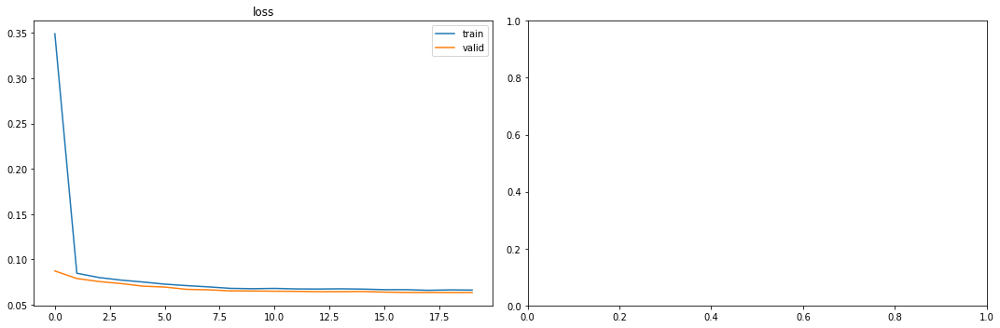

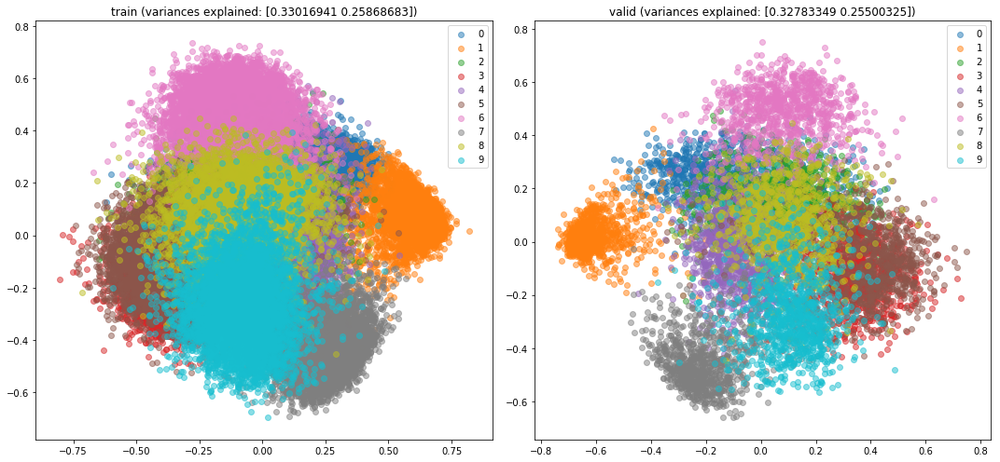

In [9]:
from datasets import SiameseMNIST
from losses import ContrastiveLoss

train_and_visualize(train_dataset, test_dataset, dataset_wraper=SiameseMNIST, projection_layers=[], model=SiameseNet, loss_fn=ContrastiveLoss(1.), n_epochs=20)

**Changing projection dimensions**

SiameseNet(
  (embedding_net): EmbeddingNet(
    (convnet): Sequential(
      (0): Conv2d(1, 32, kernel_size=(5, 5), stride=(1, 1))
      (1): PReLU(num_parameters=1)
      (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1))
      (4): PReLU(num_parameters=1)
      (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (fc): Sequential(
      (0): Linear(in_features=1024, out_features=2, bias=True)
    )
  )
)


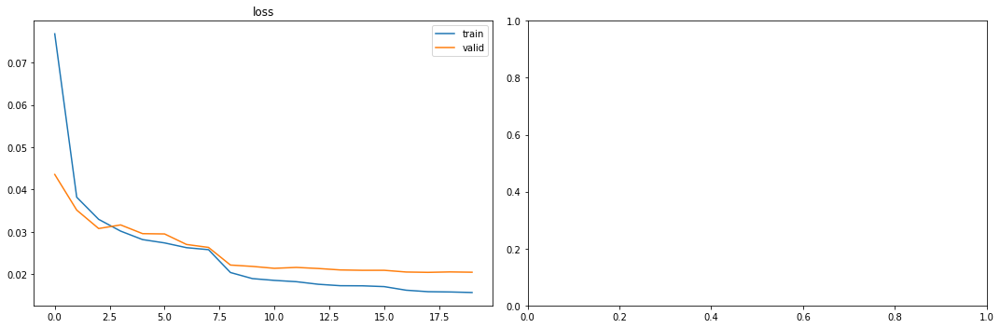

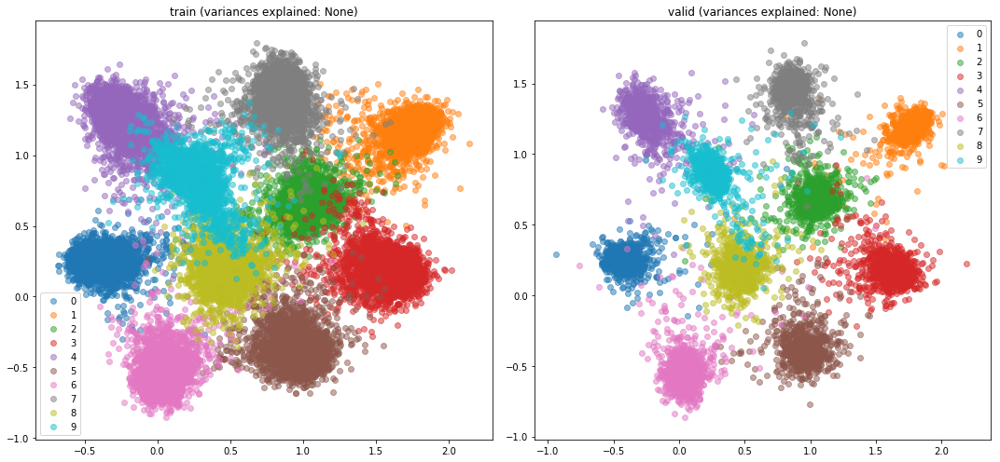

In [5]:
from datasets import SiameseMNIST
from losses import ContrastiveLoss

train_and_visualize(train_dataset, test_dataset, dataset_wraper=SiameseMNIST, projection_layers=[2], model=SiameseNet, loss_fn=ContrastiveLoss(1.), n_epochs=20)

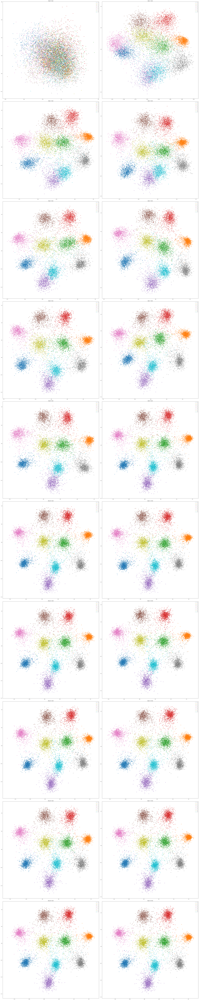

In [6]:
from datasets import SiameseMNIST
from losses import ContrastiveLoss

visualize_evolution(train_dataset, test_dataset, dataset_wraper=SiameseMNIST, projection_layers=[2], model=SiameseNet, loss_fn=ContrastiveLoss(1.), n_epochs=20)

## 3.Triplet network
We'll train a triplet network, that takes an anchor, positive (same class as anchor) and negative (different class than anchor) examples. The objective is to learn embeddings such that the anchor is closer to the positive example than it is to the negative example by some margin value.

![alt text](images/anchor_negative_positive.png "Source: FaceNet")
Source: [2] *Schroff, Florian, Dmitry Kalenichenko, and James Philbin. [Facenet: A unified embedding for face recognition and clustering.](https://arxiv.org/abs/1503.03832) CVPR 2015.*

**Triplet loss**:   $L_{triplet}(x_a, x_p, x_n) = max(0, m +  \lVert f(x_a)-f(x_p)\rVert_2^2 - \lVert f(x_a)-f(x_n)\rVert_2^2$\)

TripletNet(
  (embedding_net): EmbeddingNet(
    (convnet): Sequential(
      (0): Conv2d(1, 32, kernel_size=(5, 5), stride=(1, 1))
      (1): PReLU(num_parameters=1)
      (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1))
      (4): PReLU(num_parameters=1)
      (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (fc): Sequential(
      (0): Linear(in_features=1024, out_features=256, bias=True)
      (1): PReLU(num_parameters=1)
      (2): Linear(in_features=256, out_features=256, bias=True)
      (3): PReLU(num_parameters=1)
      (4): Linear(in_features=256, out_features=2, bias=True)
    )
  )
)


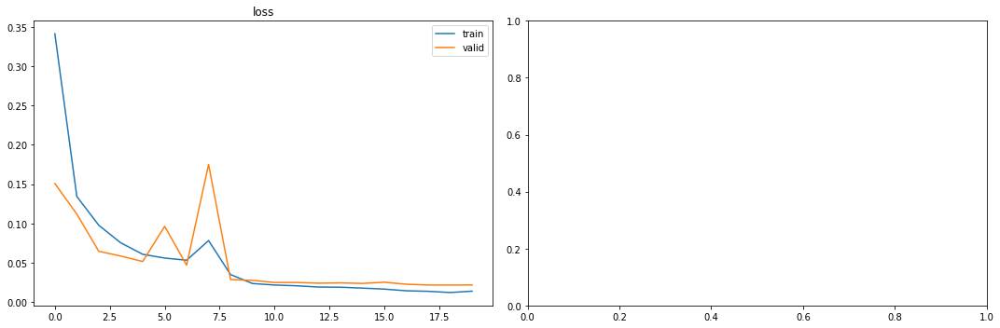

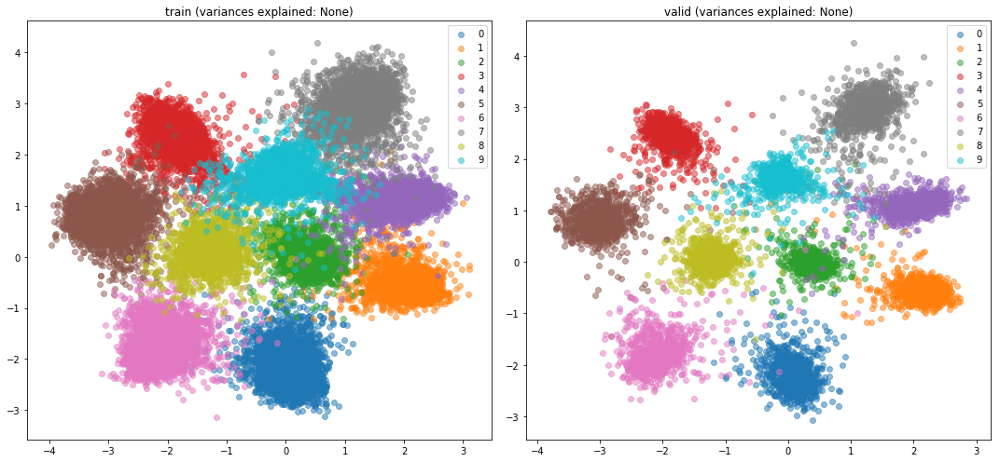

In [7]:
from datasets import TripletMNIST
from losses import TripletLoss

train_and_visualize(train_dataset, test_dataset, dataset_wraper=TripletMNIST, projection_layers=[256, 256, 2], model=TripletNet, loss_fn=TripletLoss(1.), n_epochs=20)

**Changing projection dimensions**

TripletNet(
  (embedding_net): EmbeddingNet(
    (convnet): Sequential(
      (0): Conv2d(1, 32, kernel_size=(5, 5), stride=(1, 1))
      (1): PReLU(num_parameters=1)
      (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1))
      (4): PReLU(num_parameters=1)
      (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (fc): Sequential()
  )
)


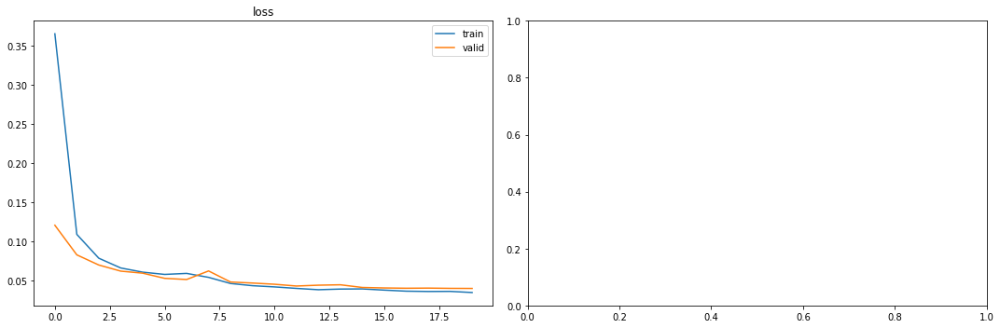

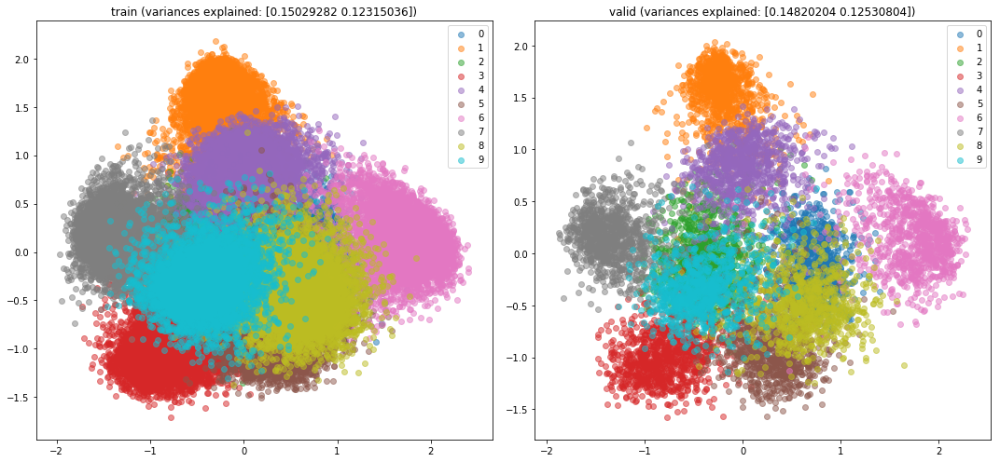

In [8]:
from datasets import TripletMNIST
from losses import TripletLoss

train_and_visualize(train_dataset, test_dataset, dataset_wraper=TripletMNIST, projection_layers=[], model=TripletNet, loss_fn=TripletLoss(1.), n_epochs=20)

TripletNet(
  (embedding_net): EmbeddingNet(
    (convnet): Sequential(
      (0): Conv2d(1, 32, kernel_size=(5, 5), stride=(1, 1))
      (1): PReLU(num_parameters=1)
      (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1))
      (4): PReLU(num_parameters=1)
      (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (fc): Sequential(
      (0): Linear(in_features=1024, out_features=2, bias=True)
    )
  )
)


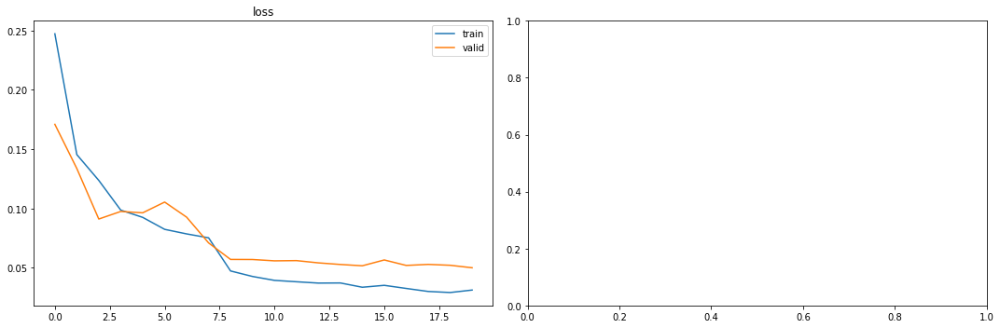

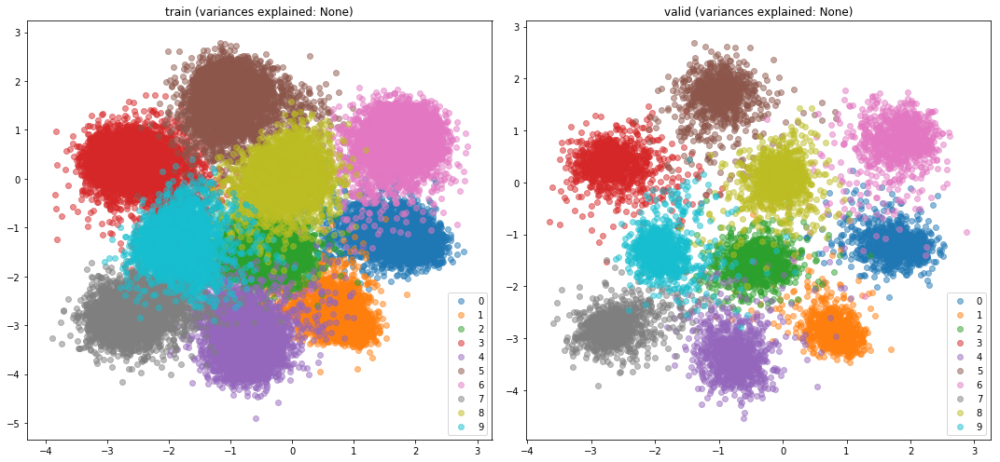

In [9]:
from datasets import TripletMNIST
from losses import TripletLoss

train_and_visualize(train_dataset, test_dataset, dataset_wraper=TripletMNIST, projection_layers=[2], model=TripletNet, loss_fn=TripletLoss(1.), n_epochs=20)

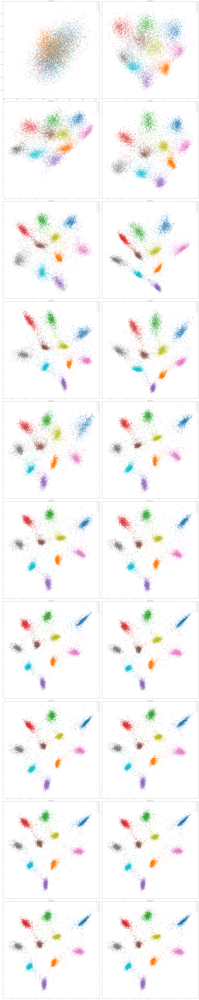

In [10]:
from datasets import TripletMNIST
from losses import TripletLoss

visualize_evolution(train_dataset, test_dataset, dataset_wraper=TripletMNIST, projection_layers=[256, 256, 2], model=TripletNet, loss_fn=TripletLoss(1.), n_epochs=20)

**Change to a bigger margin**

TripletNet(
  (embedding_net): EmbeddingNet(
    (convnet): Sequential(
      (0): Conv2d(1, 32, kernel_size=(5, 5), stride=(1, 1))
      (1): PReLU(num_parameters=1)
      (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1))
      (4): PReLU(num_parameters=1)
      (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (fc): Sequential(
      (0): Linear(in_features=1024, out_features=256, bias=True)
      (1): PReLU(num_parameters=1)
      (2): Linear(in_features=256, out_features=256, bias=True)
      (3): PReLU(num_parameters=1)
      (4): Linear(in_features=256, out_features=2, bias=True)
    )
  )
)


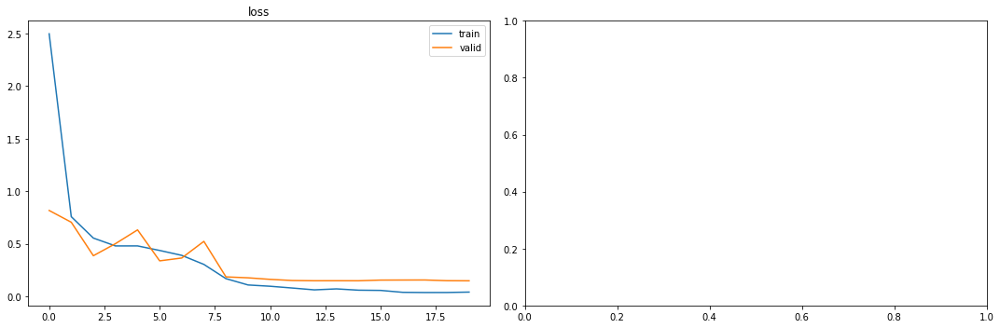

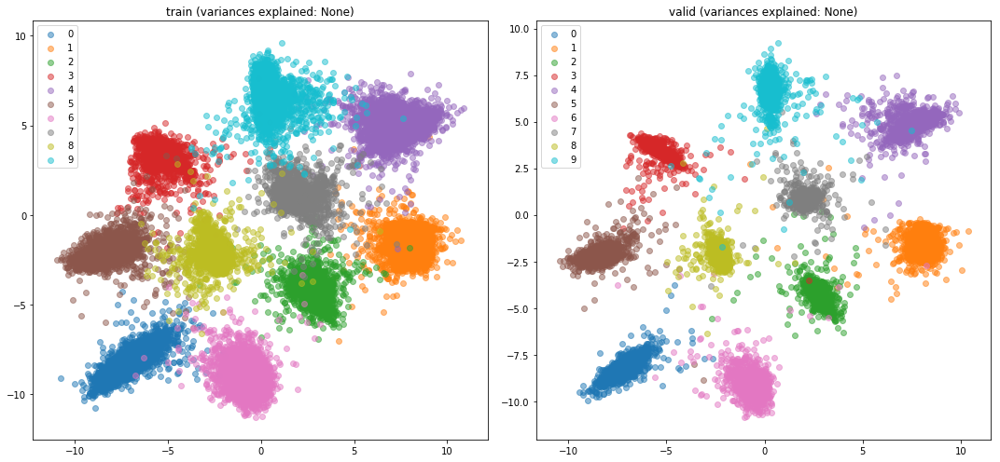

In [11]:
from datasets import TripletMNIST
from losses import TripletLoss

train_and_visualize(train_dataset, test_dataset, dataset_wraper=TripletMNIST, projection_layers=[256, 256, 2], model=TripletNet, loss_fn=TripletLoss(10.), n_epochs=20)

**does batchnorm affect the metric space?**

TripletNet(
  (embedding_net): EmbeddingNet(
    (convnet): Sequential(
      (0): Conv2d(1, 32, kernel_size=(5, 5), stride=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): PReLU(num_parameters=1)
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (4): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1))
      (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (6): PReLU(num_parameters=1)
      (7): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (fc): Sequential(
      (0): Linear(in_features=1024, out_features=256, bias=True)
      (1): PReLU(num_parameters=1)
      (2): Linear(in_features=256, out_features=256, bias=True)
      (3): PReLU(num_parameters=1)
      (4): Linear(in_features=256, out_features=2, bias=True)
    )
  )
)


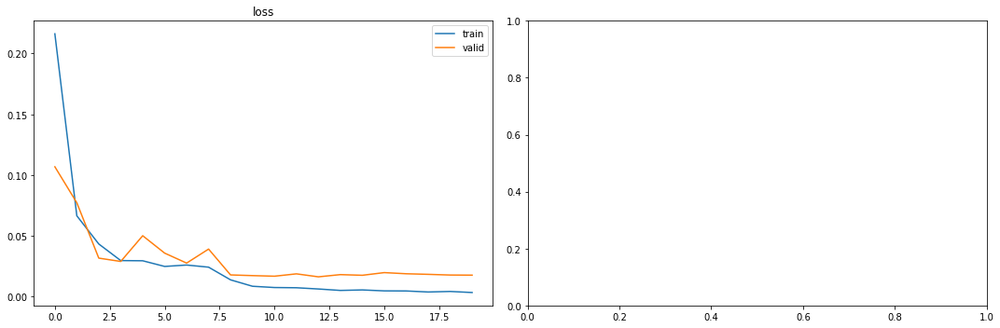

In [ ]:
from datasets import TripletMNIST
from losses import TripletLoss

train_and_visualize(train_dataset, test_dataset, dataset_wraper=TripletMNIST, projection_layers=[256, 256, 2], model=TripletNet, loss_fn=TripletLoss(1.), n_epochs=20, use_bn=True)